# Localisation of an object in am image using tensorflow, keras and google colab

Simply select "GPU" in the Accelerator drop-down in Notebook Settings (either through the Edit menu or the command palette at cmd/ctrl-shift-P).

In [0]:
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive


In [0]:
import pandas as pd
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
import cv2
import os

In [0]:


def generate_data(file_list, Y, batch_size):
    """Replaces Keras' native ImageDataGenerator."""
    i = 0
    while True:
        image_batch = []
        y_batch = []
        for b in range(batch_size):
            if i == len(file_list):
                i = 0
            sample = Y[i]
            #print(sample)
            cur = [sample[0]/480.0 , sample[1]/640.0 , sample[2]/480.0, sample[3]/640.0] 
            y_batch.append(cur)
            image = cv2.imread(os.path.join("/content/gdrive/My Drive/trainingimages", file_list[i]))
            image=cv2.resize(image,(128,128))
            image = np.resize(image,(128,128,1))
            image_batch.append(((image - 128) / 128.0))
            i += 1

        yield (np.array(image_batch), np.array(y_batch))

def generate_data_t(file_list, batch_size):
    """Replaces Keras' native ImageDataGenerator."""
    i = 0
    while True:
        image_batch = []
        for b in range(batch_size):
            if i == len(file_list):
                i = 0
            #print(sample)
            image = cv2.imread(os.path.join("/content/gdrive/My Drive/testingimages", file_list[i]))
            image = cv2.resize(image,(128,128))
            image = np.resize(image,(128,128,1))
            
            image_batch.append(((image - 128) / 128.0))
            i += 1
        yield np.array(image_batch)

In [0]:
%cd

/root


In [0]:

import numpy as np
from keras import layers
from keras.layers import Input, Dense, Activation, ZeroPadding2D, BatchNormalization, Flatten, Conv2D
from keras.layers import AveragePooling2D, MaxPooling2D, Dropout, GlobalMaxPooling2D, GlobalAveragePooling2D
from keras.models import Model
from keras.preprocessing import image
from keras.utils import layer_utils
from keras.utils.data_utils import get_file
from keras.applications.imagenet_utils import preprocess_input
import pydot
from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot
from keras.utils import plot_model
import keras.backend as K
K.set_image_data_format('channels_last')
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow

%matplotlib inline


Using TensorFlow backend.


In [0]:
from keras.engine.topology import Input
from keras.layers import BatchNormalization, Concatenate, Conv2D, Dense, Dropout, Flatten, MaxPooling2D
from keras.models import Model
# def build_model(with_dropout=True):
#     kwargs     = {'activation':'relu', 'padding':'same'}
#     conv_drop  = 0.2
#     dense_drop = 0.5
#     inp        = Input(shape=(128, 128, 1))

#     x = inp

#     x = Conv2D(64, (7, 7), strides = (1, 1), name = 'conv0')(x)
#     x = Conv2D(64, (2, 2), strides = (1, 1))(x)
#     x = BatchNormalization(axis = 3, name = 'bn0')(x)
#     x = Activation('relu')(x)

#     # MAXPOOL
#     x = Conv2D(64, (2, 2), **kwargs, strides=2)(x)
#     x = Conv2D(64, (3, 3), **kwargs)(x)
#     x = Conv2D(64, (3, 3), **kwargs)(x)
#     x = BatchNormalization()(x)
#     if with_dropout: x = Dropout(conv_drop, noise_shape=(None, 1, 1, int(x.shape[-1])))(x)

#     x = Conv2D(64, (2, 2), **kwargs, strides=2)(x)
#     x = Conv2D(64, (3, 3), **kwargs)(x)
#     x = Conv2D(64, (3, 3), **kwargs)(x)
#     x = BatchNormalization()(x)
#     if with_dropout: x = Dropout(conv_drop, noise_shape=(None, 1, 1, int(x.shape[-1])))(x)

#     x = Conv2D(64, (2, 2), **kwargs, strides=2)(x)
#     x = Conv2D(64, (3, 3), **kwargs)(x)
#     x = Conv2D(64, (3, 3), **kwargs)(x)
#     x = BatchNormalization()(x)
#     if with_dropout: x = Dropout(conv_drop, noise_shape=(None, 1, 1, int(x.shape[-1])))(x)

#     x = Conv2D(64, (2, 2), **kwargs, strides=2)(x)
#     x = Conv2D(64, (3, 3), **kwargs)(x)
#     x = Conv2D(64, (3, 3), **kwargs)(x)
#     x = BatchNormalization()(x)
#     if with_dropout: x = Dropout(conv_drop, noise_shape=(None, 1, 1, int(x.shape[-1])))(x)

#     x = Conv2D(64, (2, 2), **kwargs, strides=2)(x)
#     x = Conv2D(64, (3, 3), **kwargs)(x)
#     x = Conv2D(64, (3, 3), **kwargs)(x)
#     x = BatchNormalization()(x)
#     if with_dropout: x = Dropout(conv_drop, noise_shape=(None, 1, 1, int(x.shape[-1])))(x)

#     x = Flatten()(x)
#     x = Dense(4, activation='linear', name='fc')(x)
#     return Model(inp,x)

# happyModel = build_model(with_dropout=True)
# happyModel.summary()

In [0]:



def HappyModel(input_shape):
    """
    Implementation of the HappyModel.
    
    Arguments:
    input_shape -- shape of the images of the dataset

    Returns:
    model -- a Model() instance in Keras
    """
    
    ### START CODE HERE ###
    # Feel free to use the suggested outline in the text above to get started, and run through the whole
    # exercise (including the later portions of this notebook) once. The come back also try out other
    # network architectures as well. 
    
    X_input = Input(input_shape)
    X = X_input
    # Zero-Padding: pads the border of X_input with zeroes
    X = ZeroPadding2D((3, 3))(X)

    # CONV -> BN -> RELU Block applied to X
    X = Conv2D(64, (7, 7), strides = (1, 1), name = 'conv0')(X)
    X = Conv2D(64, (2, 2), strides = (1, 1))(X)
    X = BatchNormalization(axis = 3, name = 'bn0')(X)
    X = Activation('relu')(X)

    # MAXPOOL
    X = AveragePooling2D((4, 4), name='max_pool')(X)
    
    
    
    
    
    
    
    X = ZeroPadding2D((3, 3))(X)

    # CONV -> BN -> RELU Block applied to X
    X = Conv2D(64, (7, 7), strides = (1, 1))(X)
    X = BatchNormalization(axis = 3)(X)
    X = Activation('relu')(X)
    
    
    
    
    
    
    
    X = ZeroPadding2D((3, 3))(X)

    # CONV -> BN -> RELU Block applied to X
    X = Conv2D(64, (7, 7), strides = (1, 1))(X)
    X = BatchNormalization(axis = 3)(X)
    X = Activation('relu')(X)

    # MAXPOOL
    X = MaxPooling2D((3, 3))(X)
    
    
    
    

    
    X = ZeroPadding2D((3, 3))(X)

    # CONV -> BN -> RELU Block applied to X
    X = Conv2D(64, (7, 7), strides = (1, 1))(X)
    X = BatchNormalization(axis = 3)(X)
    X = Activation('relu')(X)

    # MAXPOOL
    X = MaxPooling2D((4, 4))(X)
    
    
    # FLATTEN X (means convert it to a vector) + FULLYCONNECTED
    X = Flatten()(X)
    X = Dense(4, activation='linear', name='fc')(X)

    
    # Create model. This creates your Keras model instance, you'll use this instance to train/test the model.
    model = Model(inputs = X_input, outputs = X, name='HappyModel')

    ### END CODE HERE ###
    
    return model

In [0]:
from keras.optimizers import Adam
happyModel = HappyModel((128, 128, 1))
happyModel.compile(Adam(lr=0.032), loss='mean_squared_error' , metrics = ['accuracy'])
happyModel.summary()

Instructions for updating:
Colocations handled automatically by placer.
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 128, 128, 1)       0         
_________________________________________________________________
zero_padding2d_1 (ZeroPaddin (None, 134, 134, 1)       0         
_________________________________________________________________
conv0 (Conv2D)               (None, 128, 128, 64)      3200      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 127, 127, 64)      16448     
_________________________________________________________________
bn0 (BatchNormalization)     (None, 127, 127, 64)      256       
_________________________________________________________________
activation_1 (Activation)    (None, 127, 127, 64)      0         
_________________________________________________________________
max_

In [0]:
file=pd.read_csv("/content/gdrive/My Drive/training.csv")
file=np.array(file)
X_train,X_test,Y_train,Y_test=train_test_split(file[:,0],file[:,1:5])
print(X_train.shape)
print(X_test.shape)

(10500,)
(3500,)


In [0]:
batch_s = 32
happyModel.fit_generator(
    generate_data(file[:,0],file[:,1:5], batch_s),
    samples_per_epoch=14000/batch_s , nb_epoch = 30)

In [0]:

preds = happyModel.evaluate_generator(generate_data(X_test , Y_test, batch_s), len(X_test)/batch_s)
#preds = happyModel.evaluate(x = X_test, y = Y_test)
### END CODE HERE ###
print()
print ("Loss = " + str(preds[0]))
print ("Test Accuracy = " + str(preds[1]))


Loss = 0.011149996015327897
Test Accuracy = 0.8920454545454546


In [0]:
# serialize model to JSON
model_json = happyModel.to_json()
with open("/content/gdrive/My Drive/model.json", "w") as json_file:
    json_file.write(model_json)
# serialize weights to HDF5
happyModel.save_weights("/content/gdrive/My Drive/model.h5")
print("Saved model to disk")

Saved model to disk


In [0]:
# load json and create model
json_file = open('/content/gdrive/My Drive/model.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)
# load weights into new model
loaded_model.load_weights("/content/gdrive/My Drive/model.h5")
print("Loaded model from disk")
 
# evaluate loaded model on test data
loaded_model.compile(loss='binary_crossentropy', optimizer='rmsprop', metrics=['accuracy'])
score = loaded_model.evaluate(X, Y, verbose=0)
print("%s: %.2f%%" % (loaded_model.metrics_names[1], score[1]*100))

In [0]:
file_t = pd.read_csv("/content/gdrive/My Drive/test.csv")
file_t = np.array(file_t)
# happyModel.save_weights('/content/gdrive/My Drive/happymodel.h5')
print(file_t.shape)


(12815, 5)


In [0]:

predict = happyModel.predict_generator(generate_data_t(file_t[:, 0], 1),len(file_t)*1.0)
print(predict)

[[0.23733842 0.8075546  0.1697107  0.60971713]
 [0.19831227 0.84237945 0.27960834 0.5705196 ]
 [0.20528696 0.8234761  0.10966007 0.6354702 ]
 ...
 [0.21427773 0.7980251  0.1232238  0.6348708 ]
 [0.20089494 0.8620484  0.30569243 0.55001736]
 [0.17267048 0.8543539  0.20859239 0.5947001 ]]


In [0]:
pre = predict*np.array([480, 640, 480, 640])

In [0]:
pre.shape

(12815, 4)

In [0]:

for i in range(0 , 12815):
  for j in range(0 , 4):
    if(pre[i, j] <= 0):
      pre[i, j] = 0

In [0]:
ans = np.concatenate((file_t[:,0].reshape(12815,1),pre),axis=1)

In [0]:
submission = pd.DataFrame(columns=['image_name', 'x1','x2','y1','y2'])
submission['image_name'] = pd.Series(ans[:,0].astype('str'))
submission['x1'] = pd.Series(pre[:,0].astype('int'))
submission['x2'] = pd.Series(pre[:,1].astype('int'))
submission['y1'] = pd.Series(pre[:,2].astype('int'))
submission['y2'] = pd.Series(pre[:,3].astype('int'))
submission.to_csv('/content/gdrive/My Drive/submission.csv', index=False)

In [0]:
happyModel.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 128, 128, 1)       0         
_________________________________________________________________
zero_padding2d_1 (ZeroPaddin (None, 134, 134, 1)       0         
_________________________________________________________________
conv0 (Conv2D)               (None, 128, 128, 64)      3200      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 127, 127, 64)      16448     
_________________________________________________________________
bn0 (BatchNormalization)     (None, 127, 127, 64)      256       
_________________________________________________________________
activation_1 (Activation)    (None, 127, 127, 64)      0         
_________________________________________________________________
max_pool (AveragePooling2D)  (None, 31, 31, 64)        0         
__________

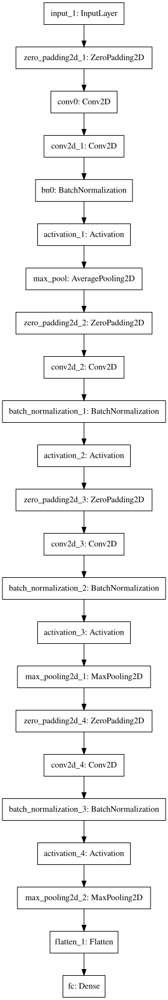

In [0]:
plot_model(happyModel, to_file='/content/gdrive/My Drive/HappyModel.png')
SVG(model_to_dot(happyModel).create(prog='dot', format='svg'))

In [0]:
happyModel.save('/content/gdrive/My Drive/happymodel.h5')

In [0]:
from keras.models import load_model
newmodel = load_model('/content/gdrive/My Drive/happymodel.h5')
newmodel.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 128, 128, 1)       0         
_________________________________________________________________
zero_padding2d_1 (ZeroPaddin (None, 134, 134, 1)       0         
_________________________________________________________________
conv0 (Conv2D)               (None, 128, 128, 64)      3200      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 127, 127, 64)      16448     
_________________________________________________________________
bn0 (BatchNormalization)     (None, 127, 127, 64)      256       
_________________________________________________________________
activation_1 (Activation)    (None, 127, 127, 64)      0         
_________________________________________________________________
max_pool (AveragePooling2D)  (None, 31, 31, 64)        0         
__________

In [0]:
newmodel.get_weights()

[array([[[[-2.59741187e-01, -8.23443457e-02,  3.44279669e-02, ...,
           -7.53064500e-03,  1.83918685e-01,  4.27193105e-01]],
 
         [[-4.60249521e-02,  1.68500507e+00, -8.73152539e-02, ...,
            8.65829885e-02,  9.13654789e-02,  7.02293336e-01]],
 
         [[ 3.12944621e-01,  1.84671330e+00, -4.34399918e-02, ...,
            2.70380497e-01, -2.87977401e-02, -5.23984611e-01]],
 
         ...,
 
         [[ 2.90229410e-01,  3.93498588e+00, -2.59407848e-01, ...,
            2.73213983e-01, -5.80529049e-02, -8.49570572e-01]],
 
         [[ 4.07849878e-01,  1.95597970e+00, -5.53902574e-02, ...,
            2.02548265e-01, -9.96997058e-02, -7.77451813e-01]],
 
         [[-1.64201502e-02,  5.19821703e-01, -1.27960816e-01, ...,
            1.42410561e-01, -2.58345045e-02, -7.24148095e-01]]],
 
 
        [[[ 1.74582529e+00,  4.76088732e-01, -1.64339803e-02, ...,
            8.21958035e-02,  4.75367457e-01, -5.77056944e-01]],
 
         [[ 9.46034074e-01,  3.06922406e-01,  8.03

In [0]:
newmodel.optimizer

In [0]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import matplotlib.patches as patches 
%matplotlib inline

In [0]:
traindf = pd.read_csv('/content/gdrive/My Drive/submission.csv', sep=',')
traindf.head(3)

,image_name,x1,x2,y1,y2
0,1474723840903DSC08089.png,113,516,81,390
1,1473231475010DeeplearnS11276.png,95,539,134,365
2,JPEG_20161205_135307_1000155917326.png,98,527,52,406


In [0]:
trainimage = traindf.loc[:,'image_name'][:500]
train10=list(trainimage[:498])
print(train10[:3])

['1474723840903DSC08089.png', '1473231475010DeeplearnS11276.png', 'JPEG_20161205_135307_1000155917326.png']


In [0]:
import glob
def load_image_and_box(dir_name = '/content/gdrive/My Drive/testingimages'):
        
    training = {}
    
    for name in glob.glob(dir_name + '/*.png'):
        
        if name[39:] in train10:
          
            training[name[39:]] = plt.imread(name)

    return training
    
    

training_imgs = load_image_and_box()

In [0]:
training_imgs['1474723840903DSC08089.png']

array([[[0.72156864, 0.7176471 , 0.7411765 ],
        [0.7176471 , 0.7137255 , 0.7372549 ],
        [0.7176471 , 0.7137255 , 0.7372549 ],
        ...,
        [0.6745098 , 0.67058825, 0.6901961 ],
        [0.6901961 , 0.6862745 , 0.7058824 ],
        [0.7490196 , 0.7529412 , 0.76862746]],

       [[0.72156864, 0.7176471 , 0.7411765 ],
        [0.7176471 , 0.7137255 , 0.7372549 ],
        [0.7176471 , 0.7137255 , 0.7372549 ],
        ...,
        [0.7019608 , 0.69803923, 0.7176471 ],
        [0.7411765 , 0.7372549 , 0.75686276],
        [0.76862746, 0.77254903, 0.7882353 ]],

       [[0.72156864, 0.7254902 , 0.74509805],
        [0.7176471 , 0.72156864, 0.7411765 ],
        [0.7137255 , 0.7176471 , 0.7372549 ],
        ...,
        [0.74509805, 0.7411765 , 0.7607843 ],
        [0.77254903, 0.7764706 , 0.7921569 ],
        [0.7607843 , 0.7647059 , 0.78039217]],

       ...,

       [[0.78039217, 0.79607844, 0.80784315],
        [0.78431374, 0.8       , 0.8117647 ],
        [0.78431374, 0

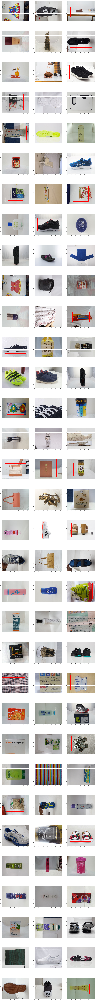

In [0]:
def visualize(imgs,rect, format=None):
    fig=plt.figure(figsize=(30,10*(len(imgs)/3)))
    for i, img in enumerate(imgs):
        if img.shape[0] == 3:
            img = img.transpose(1,2,0)
        plt_idx = i+1
        ax=fig.add_subplot(len(imgs)/3, 3, plt_idx)
        rec=patches.Rectangle((rect[i][0][0],rect[i][0][2]),rect[i][0][1]-rect[i][0][0],rect[i][0][3]-rect[i][0][2],linewidth=1,edgecolor='r',facecolor='None')
        ax.add_patch(rec)
        plt.imshow(img, cmap=format)
    plt.show()


data = [] 
rect = []
for key,value in training_imgs.items():
    data.append(value)
    rect.append(np.array(traindf[traindf['image_name'] == key].loc[:,['x1','x2','y1','y2']].values))
visualize(data[:99],rect[:99])

In [0]:
%%HTML
<iframe width='100%' height='350' src='https://google.com'></iframe>

In [0]:
import webbrowser

# generate an URL
url = 'https://' + 'www.google.com'
webbrowser.open(url)

False